# <span style = "background-color: #FFDDDD"> 프로젝트 2: Object Detection</span>

---
## <span style = "background-color: #FFFFDD"> 🍕 Environment Settings</span>

### <span style = "background-color: #F0E9FF"> 1. Import libraries & packages </span>

In [1]:
!pip3 install tensorflow-estimator==2.6.0

In [2]:
# estimate detection time
import time

# data array
import numpy as np

In [3]:
# image data handling
import tempfile 
from six.moves.urllib.request import urlopen
from six import BytesIO

from PIL import Image
from PIL import ImageColor
from PIL import ImageDraw
from PIL import ImageFont
from PIL import ImageOps


# visualization
import matplotlib.pyplot as plt

In [4]:
# machine learning
import tensorflow as tf
import tensorflow.keras as keras

# pre-trained model loader
import tensorflow_hub as hub

### <span style = "background-color: #F0E9FF"> 2. Define constants</span>

**2-1. Define pre-trained model constants**

In [5]:
FASTER_RCNN = 1
FASTER_RCNN_URL = "https://tfhub.dev/google/faster_rcnn/openimages_v4/inception_resnet_v2/1" 

In [6]:
MASK_RCNN = 2
MASK_RCNN_URL = "https://kaggle.com/models/tensorflow/mask-rcnn-inception-resnet-v2/frameworks/TensorFlow2/variations/1024x1024/versions/1"

In [7]:
MOBILE_NET = 3
MOBILE_NET_URL = "https://www.kaggle.com/models/tensorflow/ssd-mobilenet-v2/frameworks/TensorFlow2/variations/fpnlite-320x320/versions/1"

In [8]:
RETINA_NET = 4
RETINA_NET_URL = "https://kaggle.com/models/tensorflow/retinanet-resnet/frameworks/TensorFlow2/variations/50-v1-fpn-640x640/versions/1"

**2-2. Define experiment configuration constants**

In [9]:
IMG_SIZE = 256

In [10]:
coco_object_class_dict = {1: "person",
                            2: "bicycle",
                            3: "car",
                            4: "motorcycle",
                            5: "airplane",
                            6: "bus",
                            7: "train",
                            8: "truck",
                            9: "boat",
                            10: "traffic light",
                            11: "fire hydrant",
                            12: "street sign",
                            13: "stop sign",
                            14: "parking meter",
                            15: "bench",
                            16: "bird",
                            17: "cat",
                            18: "dog",
                            19: "horse",
                            20: "sheep",
                            21: "cow",
                            22: "elephant",
                            23: "bear",
                            24: "zebra",
                            25: "giraffe",
                            26: "hat",
                            27: "backpack",
                            28: "umbrella",
                            29: "shoe",
                            30: "eye glasses",
                            31: "handbag",
                            32: "tie",
                            33: "suitcase",
                            34: "frisbee",
                            35: "skis",
                            36: "snowboard",
                            37: "sports ball",
                            38: "kite",
                            39: "baseball bat",
                            40: "baseball glove",
                            41: "skateboard",
                            42: "surfboard",
                            43: "tennis racket",
                            44: "bottle",
                            45: "plate",
                            46: "wine glass",
                            47: "cup",
                            48: "fork",
                            49: "knife",
                            50: "spoon",
                            51: "bowl",
                            52: "banana",
                            53: "apple",
                            54: "sandwich",
                            55: "orange",
                            56: "broccoli",
                            57: "carrot",
                            58: "hot dog",
                            59: "pizza",
                            60: "donut",
                            61: "cake",
                            62: "chair",
                            63: "couch",
                            64: "potted plant",
                            65: "bed",
                            66: "mirror",
                            67: "dining table",
                            68: "window",
                            69: "desk",
                            70: "toilet",
                            71: "door",
                            72: "tv",
                            73: "laptop",
                            74: "mouse",
                            75: "remote",
                            76: "keyboard",
                            77: "cell phone",
                            78: "microwave",
                            79: "oven",
                            80: "toaster",
                            81: "sink",
                            82: "refrigerator",
                            83: "blender",
                            84: "book",
                            85: "clock",
                            86: "vase",
                            87: "scissors",
                            88: "teddy bear",
                            89: "hair drier",
                            90: "toothbrush",
                            91: "hair brush"}

### <span style = "background-color: #F0E9FF"> 3. Define frequently used methods</span>

**3-1. Define methods to print dividers**

In [11]:
DIVIDER_LENGTH = 80

def print_single_divider(length = DIVIDER_LENGTH):
    print("-" * DIVIDER_LENGTH)

def print_double_divider(length = DIVIDER_LENGTH):
    print("=" * DIVIDER_LENGTH)

**3-2. Define methods to display one or two images**

In [12]:
def display_img(img1, img2=None, comparison=False):
    fig = plt.figure(figsize=(30, 30))
    
    # display first image
    ax1 = fig.add_subplot(1, 2, 1)
    ax1.imshow(img1)
    ax1.axis("off")
    
    # display second image for comparison
    if comparison == True:
        ax2 = fig.add_subplot(1, 2, 2)
        ax2.imshow(img2)
        ax2.axis("off")
    
    plt.tight_layout()
    plt.show()

### <span style = "background-color: #F0E9FF"> 4. Check GPU settings</span>

In [13]:
tf.config.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

---
## <span style = "background-color: #FFFFDD"> 🍕 Data Preparation</span>

### <span style = "background-color: #F0E9FF"> 1. Define image loader methods</span>

**1-1. Define methods to load image data from url**

In [14]:
# method to get and save resized image from url
### input  : url, resizing width & height
### output : saved path

def save_img_from_url(url, resize_width, resize_height):
    # get image from url
    _, filename = tempfile.mkstemp(suffix=".jpg")
    response = urlopen(url)
    image_data = response.read()
    image_data = BytesIO(image_data)  # 이미지 읽기
    pil_image = Image.open(image_data)
    
    # resize image
    pil_image = ImageOps.fit(pil_image, (resize_width, resize_height), Image.ANTIALIAS)
    
    # convert image into RGB mode
    pil_image_rgb = pil_image.convert("RGB")
    
    # save image
    pil_image_rgb.save(filename, format="JPEG", quality=90)
        
    return filename

In [15]:
# method to get image data from data path
### input  : data path
### output : image data

def get_img_from_path(path):
    img = tf.io.read_file(path)
    img = tf.image.decode_jpeg(img, channels=3)
    return img

**1-2. Define pipleline method to get image from url**

In [16]:
def get_img_from_url(url, width=IMG_SIZE, height=IMG_SIZE):
    filename = save_img_from_url(url, resize_width=width, resize_height=height)
    img = get_img_from_path(filename)
    
    print("> Image data loaded from URL successfully!")
    display_img(img)
    
    return img

### <span style = "background-color: #F0E9FF"> 2. Load and preview test images</span>

**2-1. Load and preview 1st test image (노드 예제 이미지)**

> Image data loaded from URL successfully!


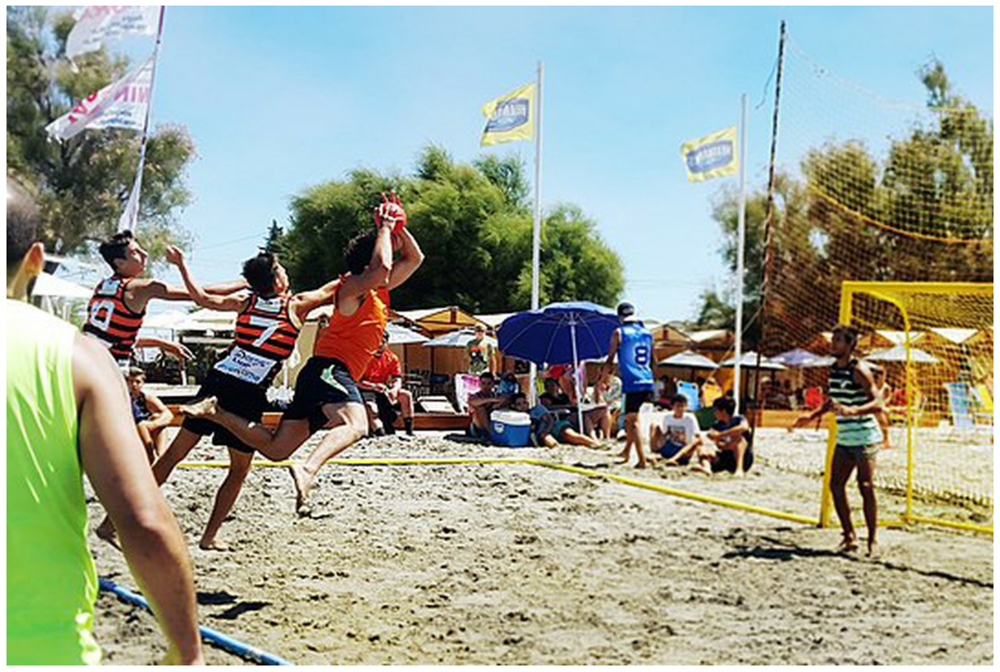

In [17]:
test_sample1_url = "https://upload.wikimedia.org/wikipedia/commons/thumb/d/db/Torneo_beach_handball.jpg/640px-Torneo_beach_handball.jpg"
test_sample1_img = get_img_from_url(test_sample1_url, width=1280, height=856)

**2-2. Load and preview 2nd test image**

> Image data loaded from URL successfully!


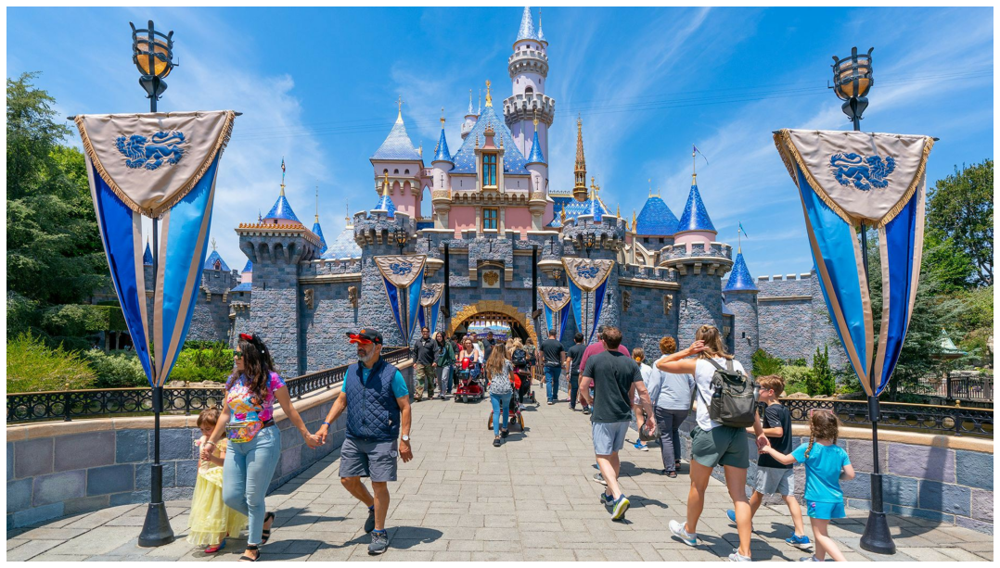

In [18]:
test_sample2_url = "https://media.cnn.com/api/v1/images/stellar/prod/gettyimages-1240948160.jpg?c=16x9"
test_sample2_img = get_img_from_url(test_sample2_url, width=1850, height=1041)

**2-3. Load and preview 3rd test image**

> Image data loaded from URL successfully!


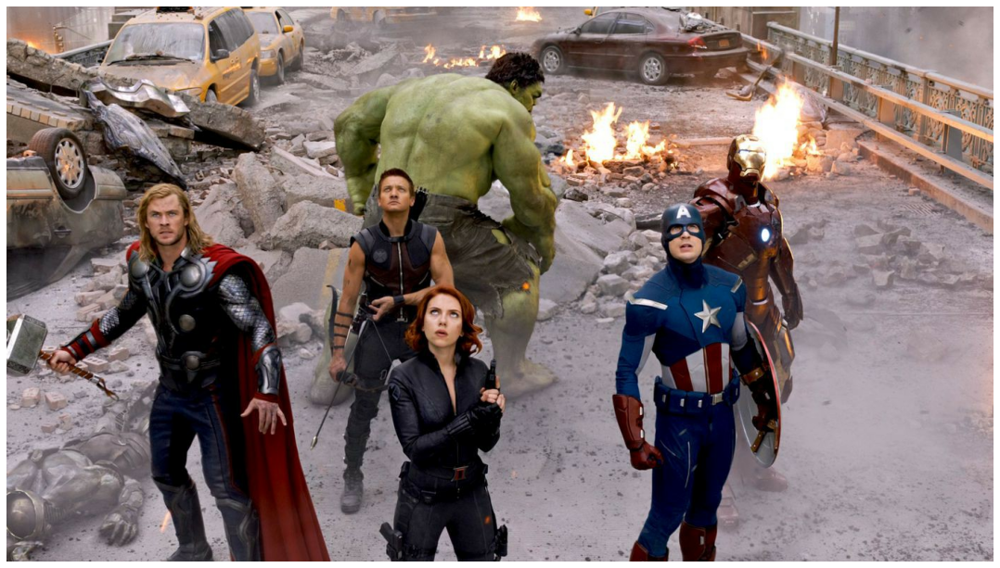

In [19]:
test_sample3_url = "https://cdn.vox-cdn.com/thumbor/dfH_3hLCZEChGYAcgMbHyFJN0pk=/1400x788/filters:format(jpeg)/cdn.vox-cdn.com/uploads/chorus_asset/file/23184567/avengers_battle_of_new_york.jpg"
test_sample3_img = get_img_from_url(test_sample3_url, width=1400, height=788)

**2-4. Load and preview 4th test image**

> Image data loaded from URL successfully!


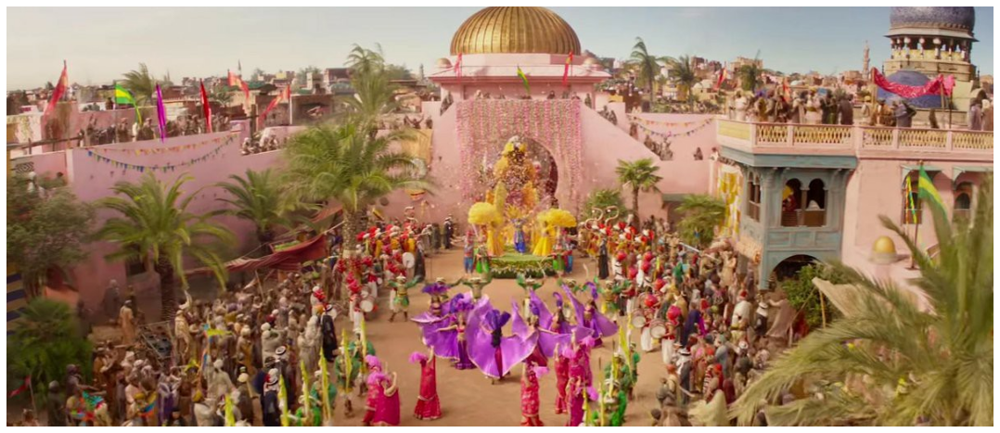

In [20]:
test_sample4_url = "https://pbs.twimg.com/media/D7iwzMrVUAAPGxM.jpg"
test_sample4_img = get_img_from_url(test_sample4_url, width=1200, height=511)

---
## <span style = "background-color: #FFFFDD"> 🍕 Model Preparation</span>

### <span style = "background-color: #F0E9FF"> 1. Define pre-trained model loader methods</span>

In [21]:
def get_pretrained_model(model_type=FASTER_RCNN):
    
    model = None
    
    if model_type == FASTER_RCNN:
        model_url = FASTER_RCNN_URL
        model = hub.load(model_url).signatures["default"]
    
    elif model_type == MASK_RCNN:
        model_url = MASK_RCNN_URL
        model = hub.load(model_url)
        
    elif model_type == MOBILE_NET:
        model_url = MOBILE_NET_URL
        model = hub.load(model_url) #.signatures["serving_default"]
        
    elif model_type == RETINA_NET:
        model_url = RETINA_NET_URL
        model = hub.load(model_url) #.signatures["serving_default"]
    
    return model

### <span style = "background-color: #F0E9FF"> 2. Generate pre-trained model instances</span>

**2-1. Generate pre-trained Faster RCNN model instance**

In [22]:
faster_rcnn_detector = get_pretrained_model(model_type = FASTER_RCNN)

INFO:tensorflow:Saver not created because there are no variables in the graph to restore


INFO:tensorflow:Saver not created because there are no variables in the graph to restore


**2-2. Generate pre-trained Mask RCNN model instance**

In [23]:
mask_rcnn_detector = get_pretrained_model(model_type = MASK_RCNN)

**2-3. Generate pre-trained MobileNet model instance**

In [24]:
mobile_net_detector = get_pretrained_model(model_type = MOBILE_NET)

**2-4. Generate pre-trained RetinaNet model instance**

In [25]:
retina_net_detector = get_pretrained_model(model_type = RETINA_NET)

---
## <span style = "background-color: #FFFFDD"> 🍕 Experiments</span>

### <span style = "background-color: #F0E9FF"> 1. Define visualizing methods</span>

In [26]:
# method to draw "one" bounding box on the image

def draw_bbox_on_img(img,
                     ymin, xmin, ymax, xmax,
                     color,
                     font,
                     thickness=4,
                     display_str_list=()):
    
    draw = ImageDraw.Draw(img)
    im_width, im_height = img.size
    (left, right, top, bottom) = (xmin * im_width, xmax * im_width,
                                  ymin * im_height, ymax * im_height)
    
    # BBox 테두리 그리기
    draw.line([(left, top), (left, bottom), (right, bottom), (right, top),
               (left, top)],
              width=thickness,
              fill=color)
    
    display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
    total_display_str_height = (1 + 2 * 0.05) * sum(display_str_heights)
    
    if top > total_display_str_height:
        text_bottom = top
    else:
        text_bottom = top + total_display_str_height
        
    
    for display_str in display_str_list[::-1]:
        text_width, text_height = font.getsize(display_str)
        margin = np.ceil(0.05 * text_height)
        draw.rectangle([(left, text_bottom - text_height - 2 * margin),
                        (left + text_width, text_bottom)],
                       fill=color)
        draw.text((left + margin, text_bottom - text_height - margin),
                  display_str,
                  fill="black",
                  font=font)
        text_bottom -= text_height - 2 * margin

In [27]:
# method to draw "all" detected bounding boxes on the image

def draw_all_bboxes_on_img(model_type, img, boxes, class_names, scores, max_boxes=10, min_score=0.1): 
    
    # get random color list
    colors = list(ImageColor.colormap.values())
    
    # get font to indicate object names
    try:
        font = ImageFont.truetype("/usr/share/fonts/truetype/liberation/LiberationSansNarrow-Regular.ttf",
                                  25)
    except IOError:
        print("> WARNING : Font not found, using default font.")
        font = ImageFont.load_default()

        
    # draw bounding boxes with different colors by object types
    for i in range(min(boxes.shape[0], max_boxes)):
        if scores[i] >= min_score:
            # get box coordinates
            ymin, xmin, ymax, xmax = tuple(boxes[i])
            
            if model_type == FASTER_RCNN:
                display_str = "{}: {}%".format(class_names[i].decode("ascii"),
                                               int(100 * scores[i]))
                color = colors[hash(class_names[i]) % len(colors)]
            
            else:    # model_type == MASK_RCNN or model_type == MOBILE_NET or model_type == RETINA_NET:
                class_str = coco_object_class_dict[int(class_names[i])]
                display_str = "{}: {}%".format(class_str[0].upper() + class_str[1:],
                                               int(100 * scores[i]))
                color = colors[hash(class_names[i]) % len(colors)]

            img_pil = Image.fromarray(np.uint8(img)).convert("RGB")
            draw_bbox_on_img(
                img_pil,
                ymin,
                xmin,
                ymax,
                xmax,
                color,
                font,
                display_str_list=[display_str])
            np.copyto(img, np.array(img_pil))
        
    return img

### <span style = "background-color: #F0E9FF"> 2. Define pipeline method to perform experiments</span>

In [28]:
def run_detector(model_type, detector, img):
    # convert image data to input to the pre-trained model
    if model_type == FASTER_RCNN:
        img_tensor = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]
    else:    # MASK_RCNN, MOBILENET, RETINANET
        img_tensor = tf.image.convert_image_dtype(img, tf.uint8)[tf.newaxis, ...]
    
    
    
    # estimate processing time for detection
    start_time = time.time()
    result = detector(img_tensor)
    end_time = time.time()
    
    
    
    # get detection result
    result = {key:value.numpy() for key,value in result.items()}

    if model_type == FASTER_RCNN:
        result_bboxes = result["detection_boxes"]
        result_classes = result["detection_class_entities"]
        result_scores = result["detection_scores"]
        
    else:    # model_type == MASK_RCNN or model_type == MOBILE_NET or model_type == RETINA_NET:
        result_bboxes = result["detection_boxes"][0]
        result_classes = result["detection_classes"][0]
        result_scores = result["detection_scores"][0]
        
    
    
    # generate image with bounding boxes    
    img_with_boxes = draw_all_bboxes_on_img(
        model_type, img.numpy(), result_bboxes, result_classes, result_scores)
    
    
    # print object detection results
    print("> Found %d objects." % len(result_scores))
    print("> Inference time: ", end_time-start_time)
    
    return img_with_boxes

---
## <span style = "background-color: #FFFFDD"> 🍕 Evaluation</span>

### <span style = "background-color: #F0E9FF"> 1. Run experiments with 1st test image</span>

> Original image : 


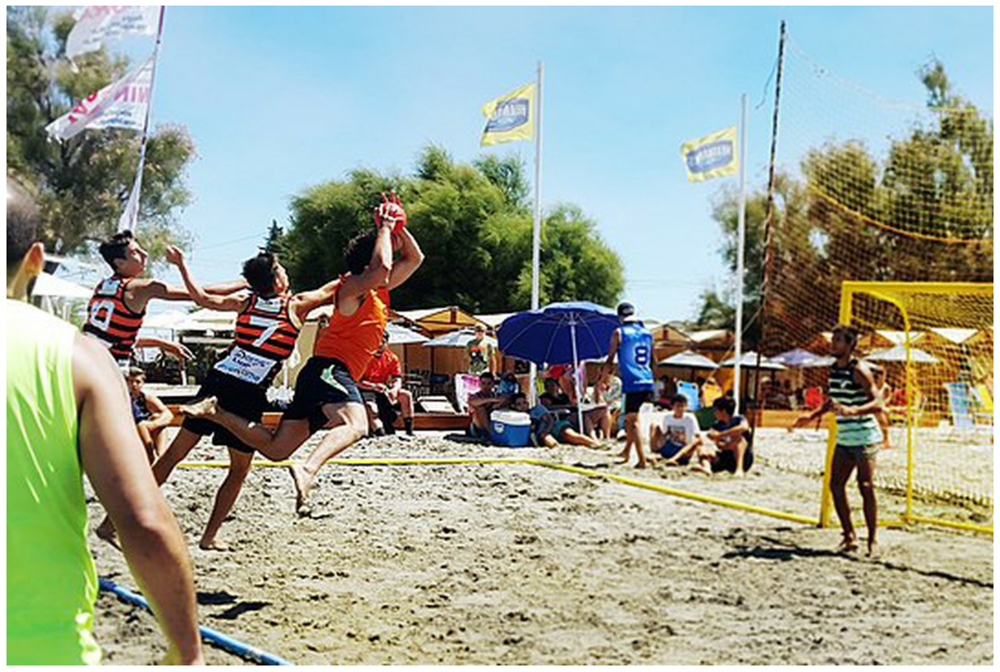

In [29]:
print("> Original image : ")
display_img(test_sample1_img)

**1-1. Object detection with Faster RCNN model**

> Found 100 objects.
> Inference time:  42.51636505126953
--------------------------------------------------------------------------------
> Objects detected by Faster RCNN : 


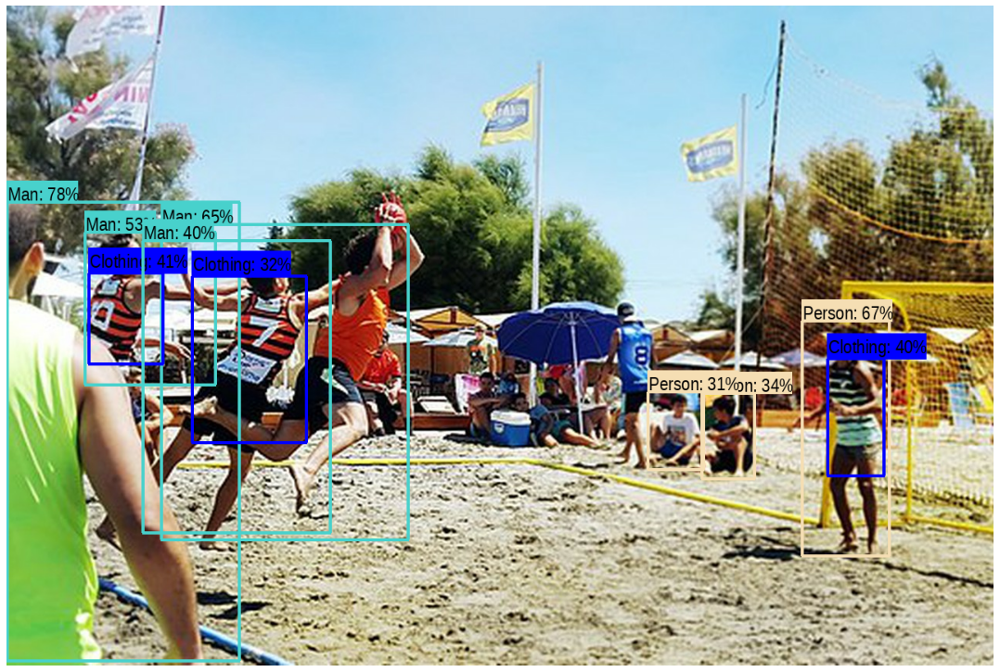

In [30]:
test_sample1_faster_rcnn_detected = run_detector(FASTER_RCNN, faster_rcnn_detector, test_sample1_img)

print_single_divider()
print("> Objects detected by Faster RCNN : ")
display_img(test_sample1_faster_rcnn_detected)

**📝 실험결과 분석**
- Person 클래스와 Man 클래스 모두 사람을 인식해냈다는 공통점으로 이해한다면, 정확하게 잘 인식했다.
- 성별의 인식이 가능하면 Man, 성별의 인식이 불가능하면 Person 으로 인식하는데, 직관적으로는 성별 또한 정확하게 잘 구분하는 듯 하다. 그러나 외관만으로 성별을 판별하는 것은 실제로도 섣부른 편견을 드러낼 수 있으므로💦 일반적인 상황에서는 굳이 성별을 구별하여 언식하지 않아도 될 것 같다.
- 사진상으로는 스포츠를 즐기는 사람들의 팔다리가 복잡하게 얽혀있기 때문에 정확한 객체 구분을 하지 못했다. 스포츠를 즐기는 사람들(주황색 유니폼)에 한하여 bounding box가 포괄적으로 표시되는 것을 확인할 수 있었다. (단, 사람이 3명이라는 것은 정확하게 인식했다)
- 상반신이 정면으로 꼿꼿하게 세워진 자세의 사람들의 경우, 옷의 형체가 잘 보이기 때문에 (사람이 몸의 일부로서 걸친 옷이 아닌) 별도의 "옷" 객체로도 인식했다. 

**1-2. Object detection with Mask RCNN model**

> Found 100 objects.
> Inference time:  17.36028218269348
--------------------------------------------------------------------------------
> Objects detected by Mask RCNN : 


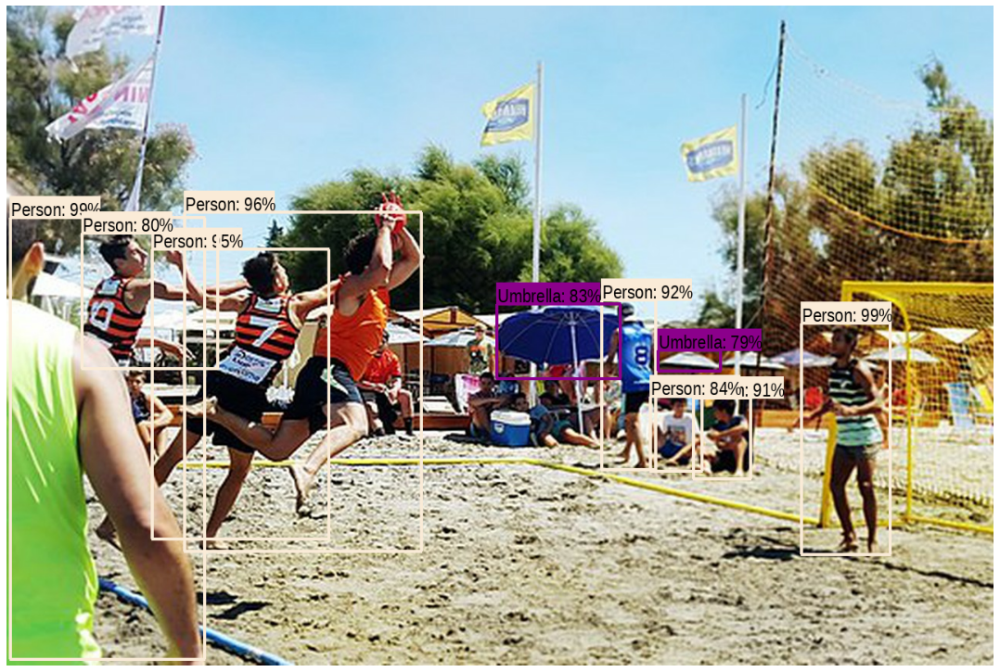

In [31]:
test_sample1_mask_rcnn_detected = run_detector(MASK_RCNN, mask_rcnn_detector, test_sample1_img)

print_single_divider()
print("> Objects detected by Mask RCNN : ")
display_img(test_sample1_mask_rcnn_detected)

**📝 실험결과 분석**
- Faster RCNN과 비교했을 때, 우측 파란색 상의의 사람 또한 인식해내었으며, 좌측의 스포츠를 즐기는 사람들 또한 팔다리가 복잡하게 얽혀있음에도 불구하고 비교적 정확하게 bounding box를 예측하였다.
- Faster RCNN과 달리 Mask RCNN의 경우, 사전 훈련 시 사람의 성별이나 옷을 별도로 학습하지 않았으므로 별도로 인식해내지 않았다. 단, 배경의 파라솔은 성공적으로 인식해냈다.

**1-3. Object detection with MobileNet model**

> Found 100 objects.
> Inference time:  4.5753068923950195
--------------------------------------------------------------------------------
> Objects detected by MobileNet : 


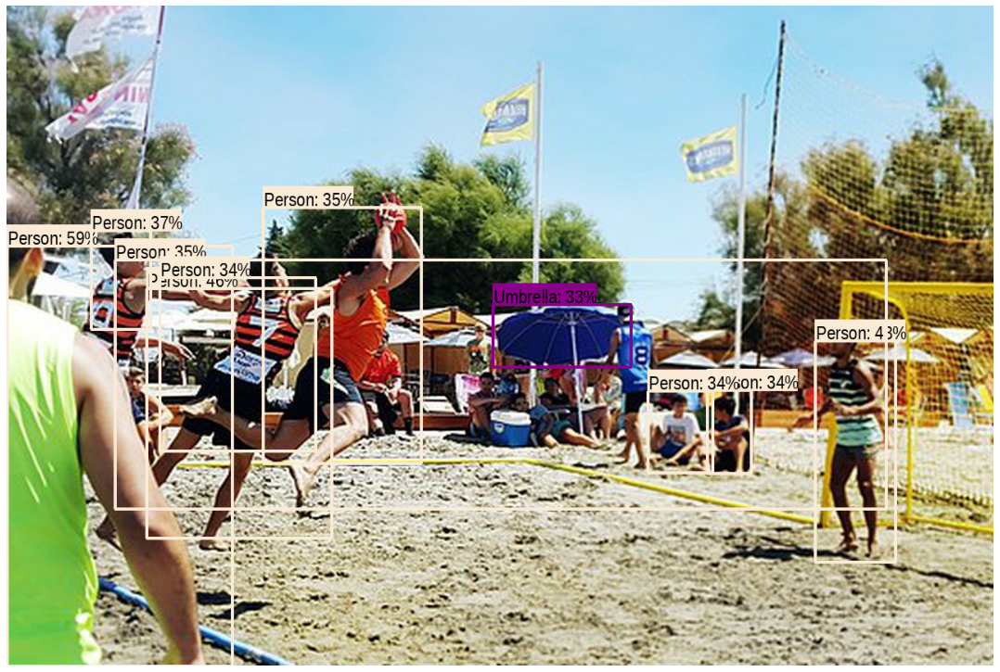

In [32]:
test_sample1_mobile_net_detected = run_detector(MOBILE_NET, mobile_net_detector, test_sample1_img)

print_single_divider()
print("> Objects detected by MobileNet : ")
display_img(test_sample1_mobile_net_detected)

**📝 실험결과 분석**
- Faster RCNN, Mask RCNN 과 달리 군중(crowd) 또한 하나의 "사람" 객체로 인식하는 듯 하다. 사진 속 사람들 개개인을 하나의 "사람" 객체로 인식한 것과 더불어 사람들의 무리 전체를 한 번 더 "사람" 객체로 인식하였다.
- Faster RCNN과 달리 MobileNet의 경우, 사전 훈련 시 사람의 성별이나 옷을 별도로 학습하지 않았으므로 별도로 인식해내지 않았다. 단, 배경의 파라솔은 성공적으로 인식해냈으나, Mask RCNN 처럼 배경 속의 작은 파라솔까지는 인식하지 못했다.

**1-4. Object detection with RetinaNet model**

> Found 100 objects.
> Inference time:  4.958984613418579
--------------------------------------------------------------------------------
> Objects detected by RetinaNet : 


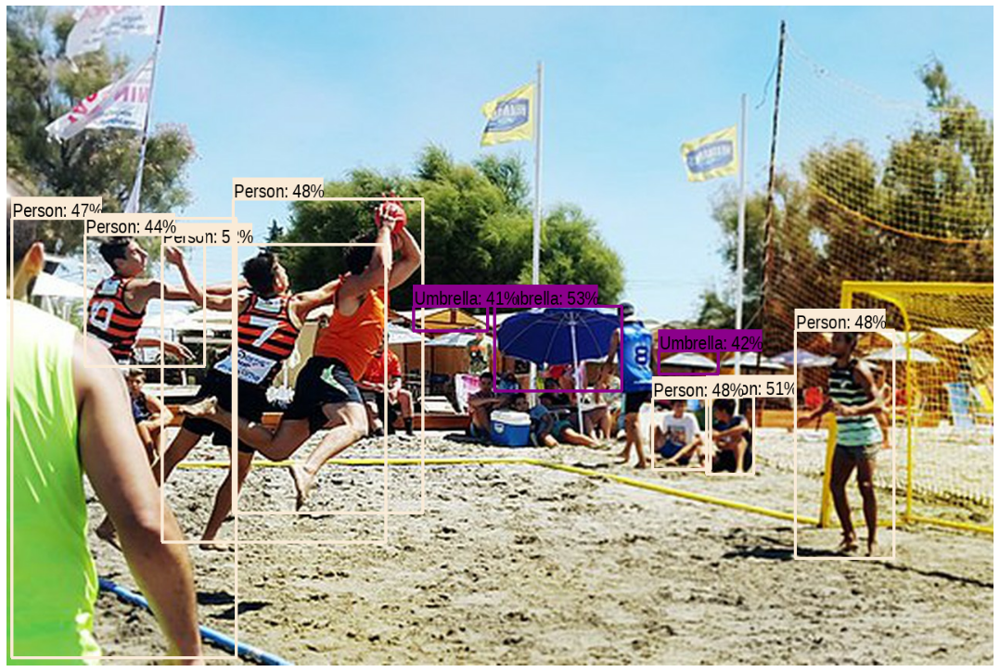

In [33]:
test_sample1_retina_net_detected = run_detector(RETINA_NET, retina_net_detector, test_sample1_img)

print_single_divider()
print("> Objects detected by RetinaNet : ")
display_img(test_sample1_retina_net_detected)

**📝 실험결과 분석**
- 사물 인식 결과는 Mask RCNN과 유사하나, 정확도 수치는 비교적 낮은 편이다
- Faster RCNN과 달리 RetinaNet의 경우, 사전 훈련 시 사람의 성별이나 옷을 별도로 학습하지 않았으므로 별도로 인식해내지 않았다.

### <span style = "background-color: #F0E9FF"> 2. Run experiments with 2nd test image</span>

> Original image : 


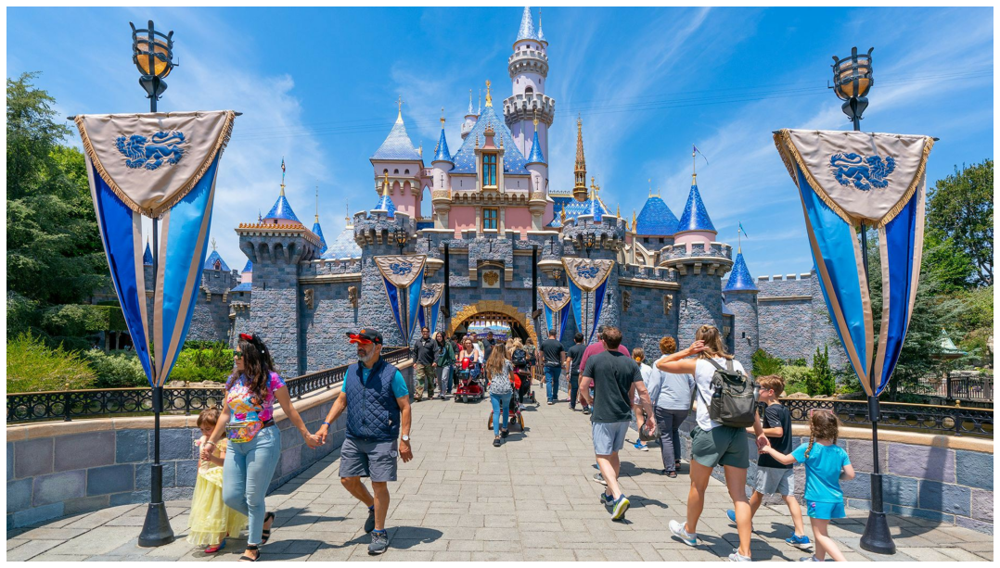

In [34]:
print("> Original image : ")
display_img(test_sample2_img)

**2-1. Object detection with Faster RCNN model**

> Found 100 objects.
> Inference time:  3.684208869934082
--------------------------------------------------------------------------------
> Objects detected by Faster RCNN : 


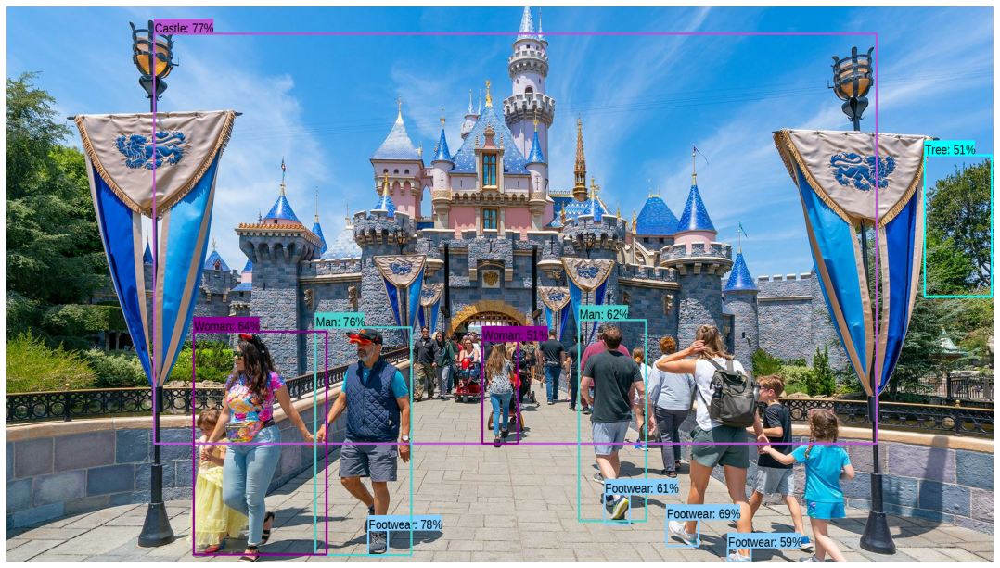

In [35]:
test_sample2_faster_rcnn_detected = run_detector(FASTER_RCNN, faster_rcnn_detector, test_sample2_img)

print_single_divider()
print("> Objects detected by Faster RCNN : ")
display_img(test_sample2_faster_rcnn_detected)

**📝 실험결과 분석**
- 일부 Man과 Woman은 정확하게 인식하였으나, 그 외에 다른 사람들은 (성별 구분이 없는) Person 으로도조차 인식하지 못했다.
- 1번 테스트 사진과 달리 옷을 인식하지는 못하였으나, 신발(Footwear)은 인식해냈다.
- 배경의 Castle을 인식하였으나, bounding box의 경계가 명확하지 않다. (패턴이 비슷해서인지 가로등의 깃발까지 모두 성의 일부로 인식하고 있는 듯 하다)
- 배경의 일부를 Tree로 인식하였다.

**2-2. Object detection with Mask RCNN model**

> Found 100 objects.
> Inference time:  0.6389980316162109
--------------------------------------------------------------------------------
> Objects detected by Mask RCNN : 


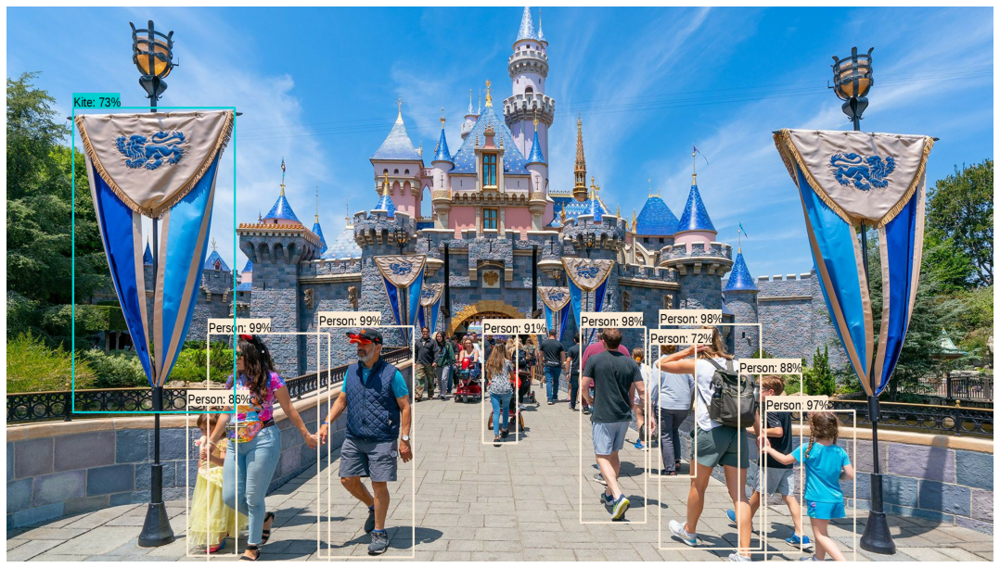

In [36]:
test_sample2_mask_rcnn_detected = run_detector(MASK_RCNN, mask_rcnn_detector, test_sample2_img)

print_single_divider()
print("> Objects detected by Mask RCNN : ")
display_img(test_sample2_mask_rcnn_detected)

**📝 실험결과 분석**
- Faster RCNN과 비교했을 때, 전경에 보이는 사람들은 모두 성공적으로 인식했다.
- 왼쪽 가로등의 깃발 장식 또한 "Kite" 객체로 인식하였는데, 오른쪽 가로등의 장식은 인식하지 못하였다. (사진에는 거의 똑같은 모양새로 나왔는데 왜지?)
- Faster RCNN과 달리 Mask RCNN의 경우, 사전 훈련 시 사람의 성별이나 옷을 별도로 학습하지 않았으므로 별도로 인식해내지 않았다.

**2-3. Object detection with MobileNet model**

> Found 100 objects.
> Inference time:  0.06816363334655762
--------------------------------------------------------------------------------
> Objects detected by MobileNet : 


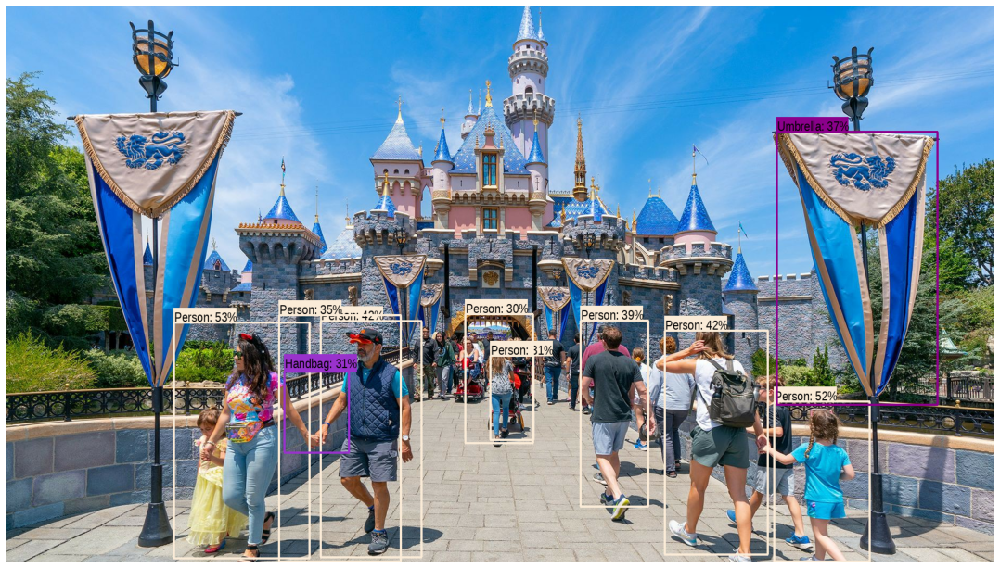

In [37]:
test_sample2_mobile_net_detected = run_detector(MOBILE_NET, mobile_net_detector, test_sample2_img)

print_single_divider()
print("> Objects detected by MobileNet : ")
display_img(test_sample2_mobile_net_detected)

**📝 실험결과 분석**
- Faster RCNN과 비교했을 때, 전경에 보이는 사람들을 대부분 인식해내었으나, Mask RCNN과 비교하면 누락된 객체가 존재한다.
- 왼쪽의 손을 잡고 걷는 부부의 경우 팔이 얽혀서인지 2명이 아닌 3명의 사람으로 인식하였고, 맞잡은 손은 "Handbag"으로 인식하였다.
- 오른쪽 깃발 장식을 "Umbrella" 객체로 인식하였는데, 왼쪽 가로등의 장식은 인식하지 못하였다. (사진에는 거의 똑같은 모양새로 나왔는데 왜지?)
- Faster RCNN과 달리 MobileNet의 경우, 사전 훈련 시 사람의 성별이나 옷을 별도로 학습하지 않았으므로 별도로 인식해내지 않았다.

**2-4. Object detection with RetinaNet model**

> Found 100 objects.
> Inference time:  0.19393658638000488
--------------------------------------------------------------------------------
> Objects detected by RetinaNet : 


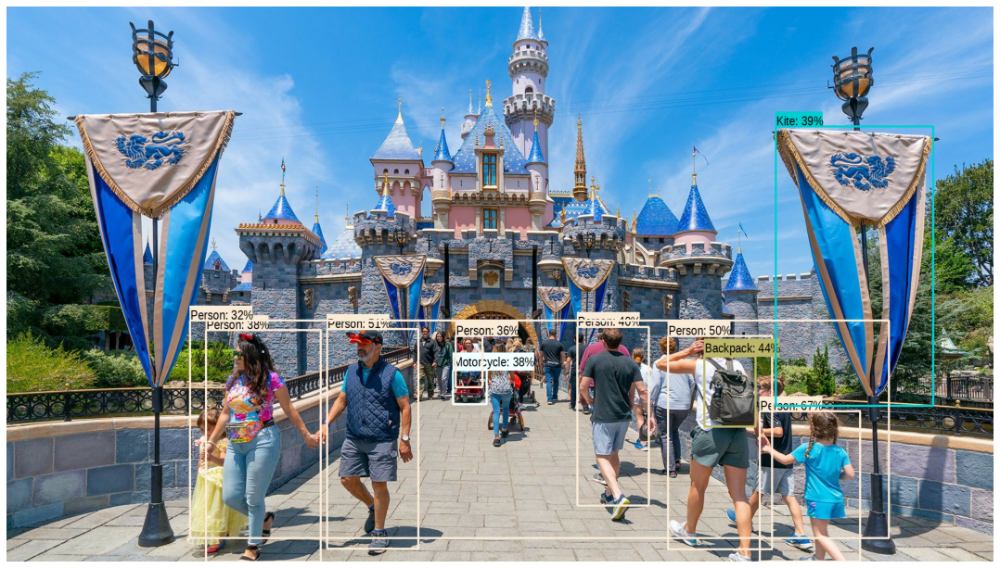

In [38]:
test_sample2_retina_net_detected = run_detector(RETINA_NET, retina_net_detector, test_sample2_img)

print_single_divider()
print("> Objects detected by RetinaNet : ")
display_img(test_sample2_retina_net_detected)

**📝 실험결과 분석**
- Faster RCNN과 비교했을 때, 전경에 보이는 사람들을 대부분 인식해내었다. 군중(crowd) 또한 하나의 "사람" 객체로 인식하는 듯 하다. 사진 속 사람들 개개인을 하나의 "사람" 객체로 인식한 것과 더불어 사람들의 무리 전체를 한 번 더 "사람" 객체로 인식하였다.
- 오른쪽 사람이 매고 있는 가방을 "Backpack"으로 성공적으로 인식하였다. 또한 배경의 사람이 끌고 있는 자동차 모양 유모차를 "Motorcycle"로 인식하였다.
- 오른쪽 깃발 장식을 "Kite" 객체로 인식하였는데, 왼쪽 가로등의 장식은 인식하지 못하였다. (사진에는 거의 똑같은 모양새로 나왔는데 왜지?)
- Faster RCNN과 달리 RetinaNet의 경우, 사전 훈련 시 사람의 성별이나 옷을 별도로 학습하지 않았으므로 별도로 인식해내지 않았다.

### <span style = "background-color: #F0E9FF"> 3. Run experiments with 3rd test image</span>

> Original image : 


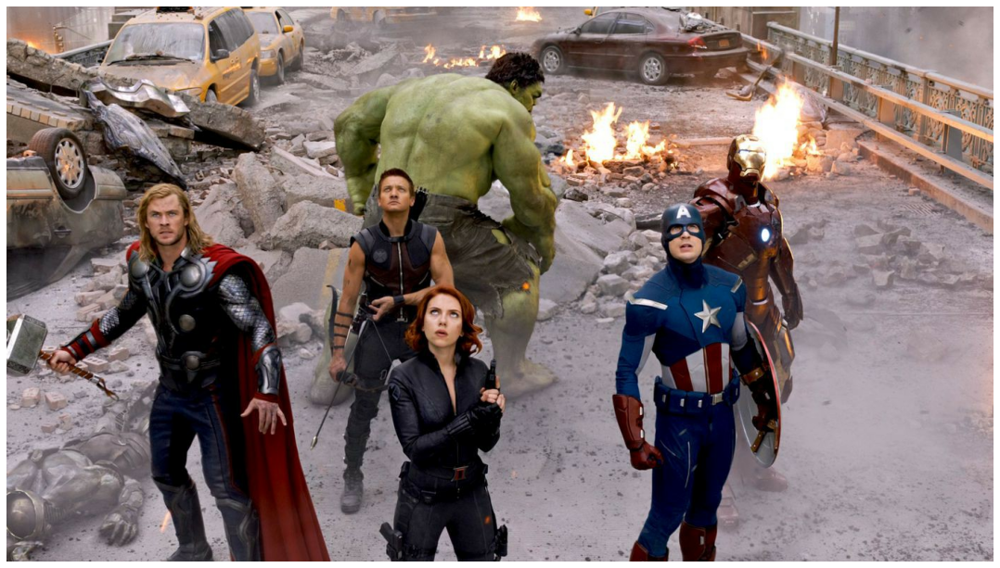

In [39]:
print("> Original image : ")
display_img(test_sample3_img)

**3-1. Object detection with Faster RCNN model**

> Found 100 objects.
> Inference time:  1.4499216079711914
--------------------------------------------------------------------------------
> Objects detected by Faster RCNN : 


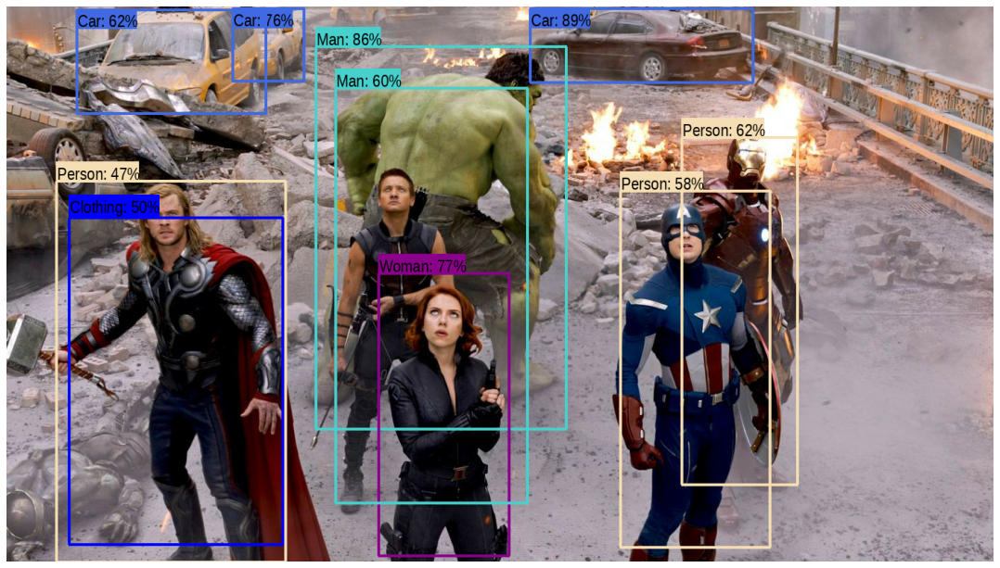

In [40]:
test_sample3_faster_rcnn_detected = run_detector(FASTER_RCNN, faster_rcnn_detector, test_sample3_img)

print_single_divider()
print("> Objects detected by Faster RCNN : ")
display_img(test_sample3_faster_rcnn_detected)

**📝 실험결과 분석**
- Woman과 Man을 정확하게 인식하였다. 마스크를 쓰고 있는 캡틴 아메리카와 아이언맨은 성별 구별이 어려웠는지 "Person" 으로 인식했다. 토르의 성별도 구별하지 못한 이유는 머리도 길고 수염도 있기 때문일까?
- 호크아이의 bounding box 면적이 굉장히 넓은데, 헐크의 일부를 호크아이로 인식한 듯 하다.
- 배경의 자동차 또한 정확하게 인식해냈다. 특히 왼쪽의 노란 택시들이 여러대 겹쳐져 있음에도 불구하고 개별적으로 구별해냈다.

**3-2. Object detection with Mask RCNN model**

> Found 100 objects.
> Inference time:  0.6874504089355469
--------------------------------------------------------------------------------
> Objects detected by Mask RCNN : 


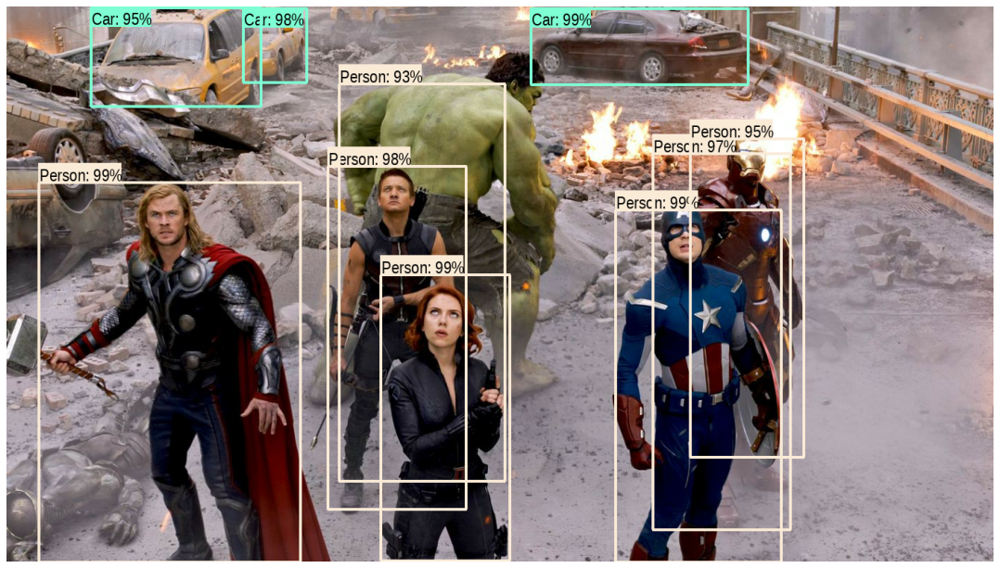

In [41]:
test_sample3_mask_rcnn_detected = run_detector(MASK_RCNN, mask_rcnn_detector, test_sample3_img)

print_single_divider()
print("> Objects detected by Mask RCNN : ")
display_img(test_sample3_mask_rcnn_detected)

**📝 실험결과 분석**
- 사진 속 모든 인물을 모두 인식하였다. 단 아이언맨은 머리 전체를 감싸는 마스크를 쓰고 있어서 인식이 어려웠는지 2명의 사람으로 인식되었다. Faster RCNN과 비교하였을 때, 호크아이의 bounding box가 정확하게 표시되었고 반면 헐크의 bounding box가 헐크의 일부분에 한하여 표시되었다.
- 배경의 자동차는 Faster RCNN과 마찬가지로 정확하게 인식하였다.

**3-3. Object detection with MobileNet model**

> Found 100 objects.
> Inference time:  0.06650018692016602
--------------------------------------------------------------------------------
> Objects detected by MobileNet : 


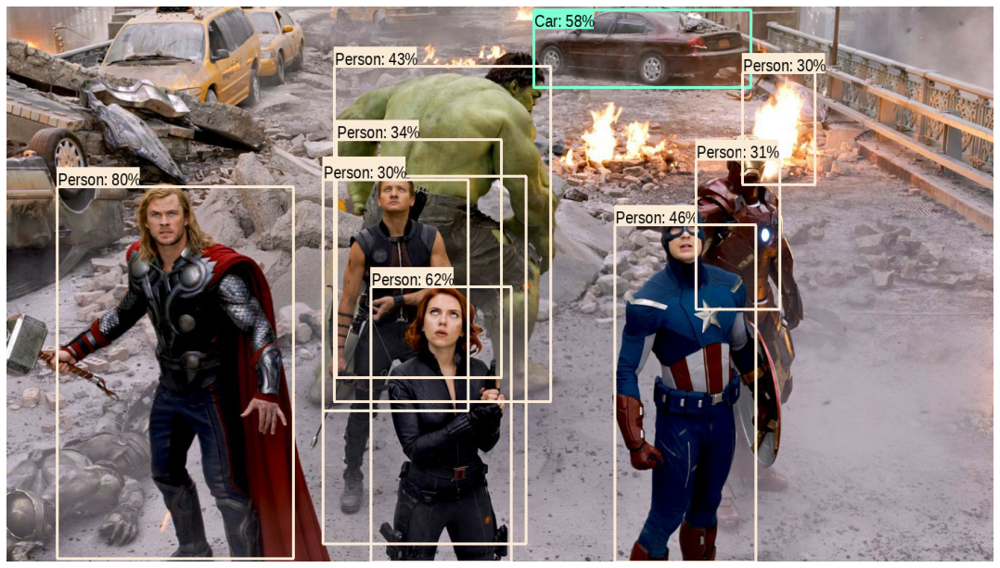

In [42]:
test_sample3_mobile_net_detected = run_detector(MOBILE_NET, mobile_net_detector, test_sample3_img)

print_single_divider()
print("> Objects detected by MobileNet : ")
display_img(test_sample3_mobile_net_detected)

**📝 실험결과 분석**
- 사진 속 모든 인물을 모두 인식하였다. 단 호크아이는 헐크의 뒷모습과 명확한 구별이 어려웠는지 두 사람으로 인식되었다. Faster RCNN과 Mask RCNN은 호크아이와 헐크의 bounding box를 정확하게 인식하지 못했는데, MobileNet의 경우 비교적 정확하게 인식하였다. (호크아이가 두 사람으로 인식되지만 않았다면 좋았을텐데)
- 뒷배경의 불꽃도 사람으로 인식되어 버렸다. 불, 물, 안개 등은 뚜렷한 형체를 묘사하기 어려워 컴퓨터 그래픽스 분야에서도 상당히 어려운 주제로 손꼽히는데, 고난이도의 소재임을 감안하면 어느 정도의 오류도 수용할 수 있을 듯 하다. 다만 뚜렷한 이목구비나 팔다리 형체가 보이지 않는데 왜 다른 사물도 아닌 굳이 "Person"으로 인식햇는지는 미지수
- 배경의 자동차는 형체가 명확하게 표시된 오른쪽 검은 차량만 인식되었으며, 정면의 모습으로 여러 대 겹쳐져서 연출된 왼쪽의 택시들은 전혀 인식하지 못했다.

**3-4. Object detection with RetinaNet model**

> Found 100 objects.
> Inference time:  0.19170165061950684
--------------------------------------------------------------------------------
> Objects detected by RetinaNet : 


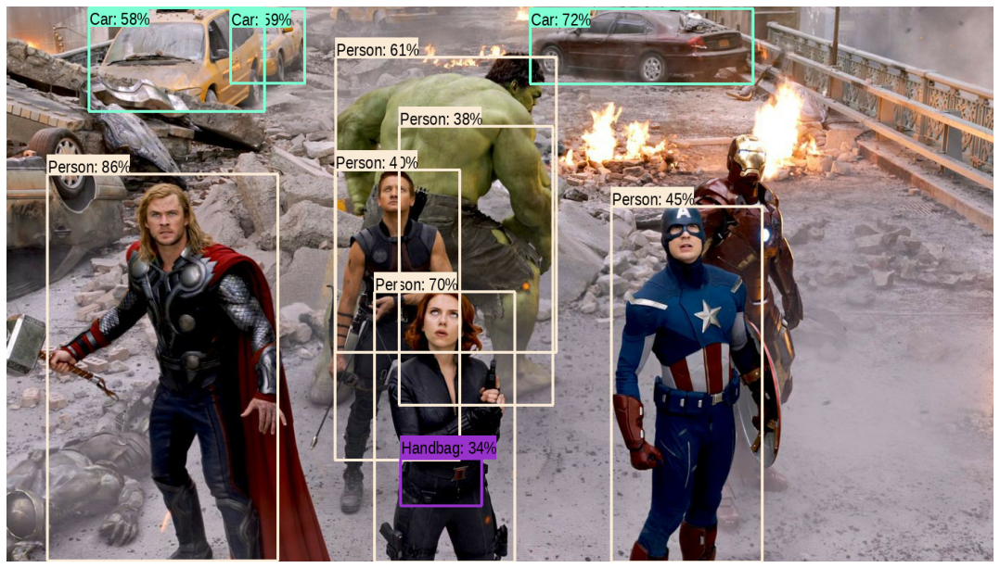

In [43]:
test_sample3_retina_net_detected = run_detector(RETINA_NET, retina_net_detector, test_sample3_img)

print_single_divider()
print("> Objects detected by RetinaNet : ")
display_img(test_sample3_retina_net_detected)

**📝 실험결과 분석**
- 사진 속 모든 인물을 대부분 인식하였으나, 아이언맨을 아예 인식하지 못하였다. 머리 전체를 감싸는 마스크 때문에 이목구비 형태가 보이지 않아서일까? 또한 MobileNet과 마찬가지로 헐크와 호크아이의 경계가 명확하지 않아 헐크가 두 사람으로 인식되었다.
- 블랙 위도우의 벨트 부분이 "Handbag"으로 인식되었다.
- 배경의 자동차는 Faster RCNN, Mask RCNN과 마찬가지로 정확하게 인식하였다.

### <span style = "background-color: #F0E9FF"> 4. Run experiments with 4th test image</span>

> Original image : 


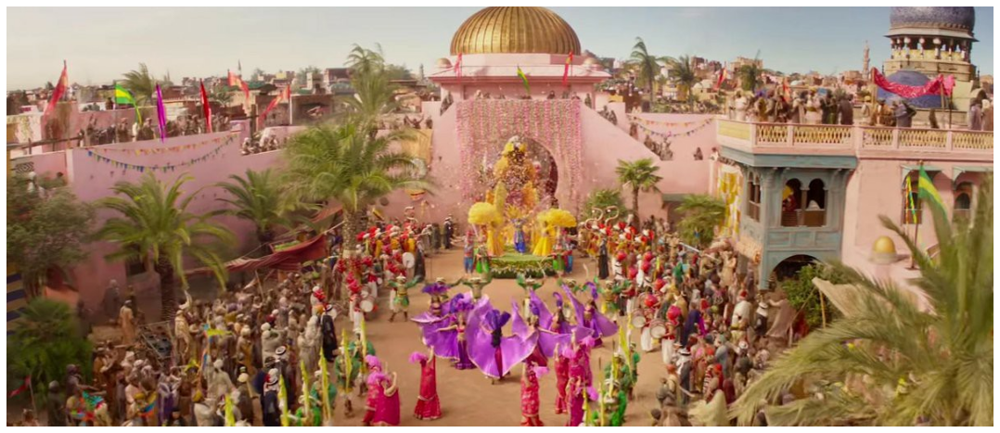

In [44]:
print("> Original image : ")
display_img(test_sample4_img)

**4-1. Object detection with Faster RCNN model**

> Found 100 objects.
> Inference time:  3.267512559890747
--------------------------------------------------------------------------------
> Objects detected by Faster RCNN : 


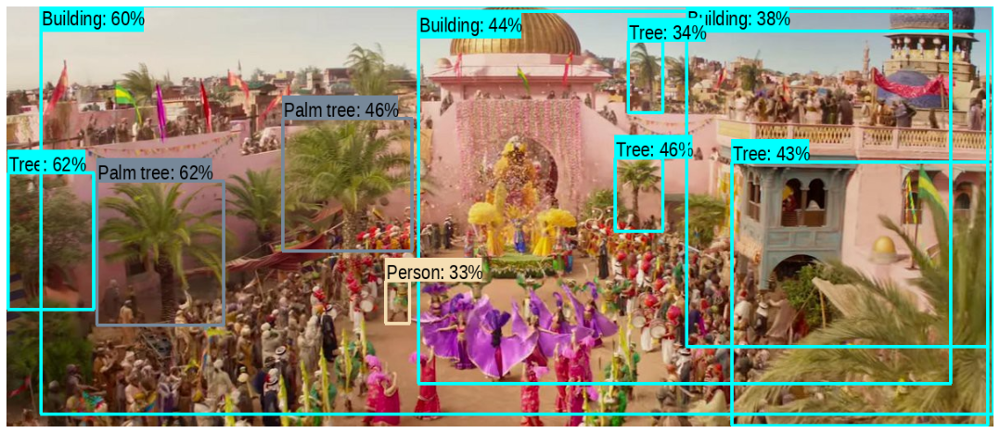

In [45]:
test_sample4_faster_rcnn_detected = run_detector(FASTER_RCNN, faster_rcnn_detector, test_sample4_img)

print_single_divider()
print("> Objects detected by Faster RCNN : ")
display_img(test_sample4_faster_rcnn_detected)

**📝 실험결과 분석**
- 사진 속의 건물들과 나무 위주로 인식하였다. 실제 영화 속 건물은 "성벽" 형태로 모두 연결된 벽면을 가지고 있고, 사진상으로도 동일한 분홍색의 벽면을 가지고 있음에도 불구하고 여러 개의 빌딩으로 인식하였다.
- 사진 속에는 여러 그루의 야자수가 있는데, 일부 야자수만 인식하였다. 사진 속으로 보이는 크기와 상관없이 부분적으로 인식해내는 것으로 봐서는, 거리(사진 상으로 비치는 크기)에 따라 인식 정확도가 낮아지는 것은 아닌 것 같다. 사진 속 나무들은 모두 야자수로 동일한 종인데, 일부 나무는 "Palm tree", 다른 일부 나무는 "Tree"로 인식하였다. 왜지?
- 사진 속에는 다수의 군중이 보이는데, 딱 한 명의 사람만, 그것도 정확하게, 인식하였다. 왜지?

**4-2. Object detection with Mask RCNN model**

> Found 100 objects.
> Inference time:  0.9343526363372803
--------------------------------------------------------------------------------
> Objects detected by Mask RCNN : 


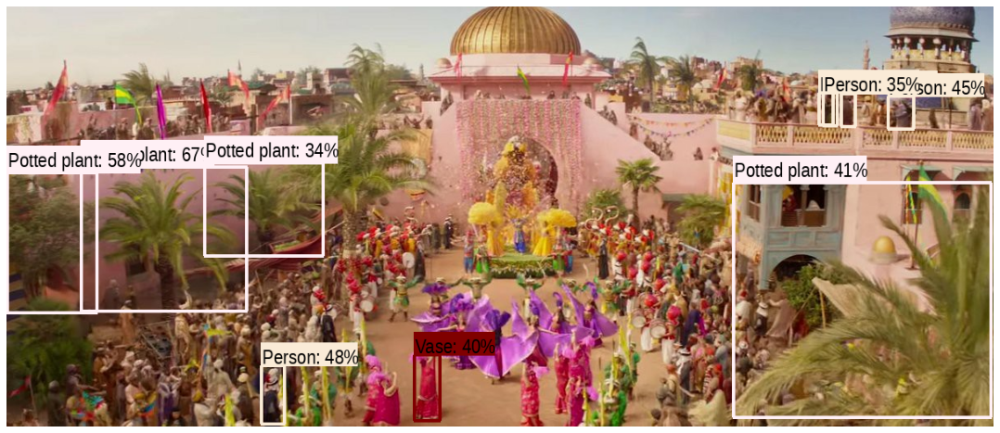

In [46]:
test_sample4_mask_rcnn_detected = run_detector(MASK_RCNN, mask_rcnn_detector, test_sample4_img)

print_single_divider()
print("> Objects detected by Mask RCNN : ")
display_img(test_sample4_mask_rcnn_detected)

**📝 실험결과 분석**
- 사진 속에는 여러 그루의 야자수가 있는데, Faster RCNN과 마찬가지로 일부 야자수만 인식하였다. 단, Faster RCNN과 달리 가까운 야자수(사진상으로 큼직하게 보이는) 위주로 인식하였고 멀리 보이는 (사진상으로 작게 보이는) 야자수는 인식하지 못했다. 사전 학습 시 "Palm tree", "Tree" 클래스에 대한 학습을 수행하지 않고 "Potted plant" 클래스에 대한 학습을 수행했기 때문에, 정확한 명칭 보다는 "Potted plant"로 대체하여 인식한 것이 인상적이다.
- 군중들 속에서 단 한 사람만 인식한 FasterRCNN과 달리 4명의 사람을 인식하였다.
- 사전 훈련 시 건물이나 배경 오브젝트 클래스에 대한 내용을 학습하지 않았으므로, Faster RCNN과 달리 배경 건물은 별도로 인식하지 않았다.

**4-3. Object detection with MobileNet model**

> Found 100 objects.
> Inference time:  0.06840133666992188
--------------------------------------------------------------------------------
> Objects detected by MobileNet : 


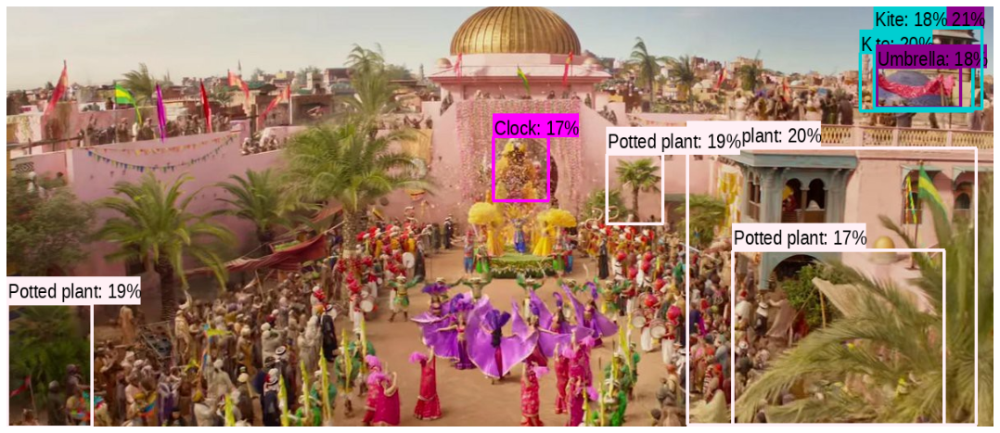

In [47]:
test_sample4_mobile_net_detected = run_detector(MOBILE_NET, mobile_net_detector, test_sample4_img)

print_single_divider()
print("> Objects detected by MobileNet : ")
display_img(test_sample4_mobile_net_detected)

**📝 실험결과 분석**
- Mask RCNN과 마찬가지로 야자수 일부를 "Potted plant"로 대체하여 인식하였다.
- 건물이나 퍼레이드의 장식물을 "Kite", "Umbrella", "Clock" 등으로 인식하였다.
- Faster RCNN, Mask RCNN과 달리 사람을 인식하지는 못 했다.

**4-4. Object detection with RetinaNet model**

> Found 100 objects.
> Inference time:  0.1812596321105957
--------------------------------------------------------------------------------
> Objects detected by RetinaNet : 


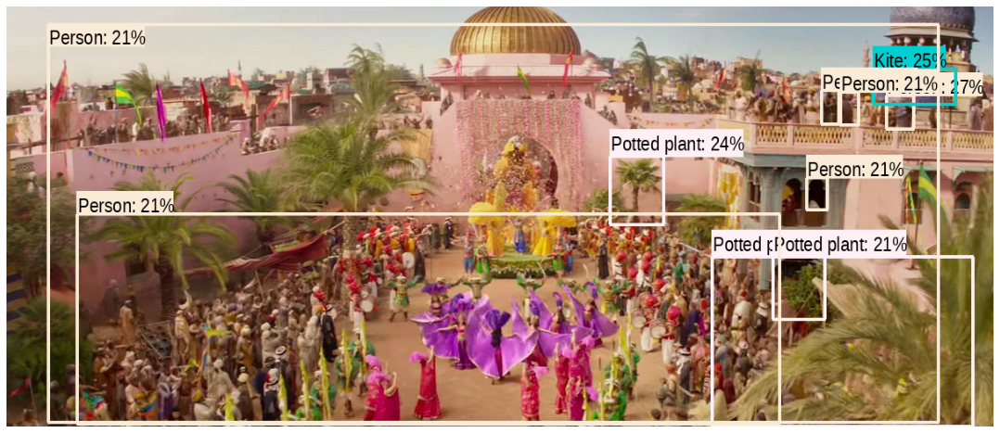

In [48]:
test_sample4_retina_net_detected = run_detector(RETINA_NET, retina_net_detector, test_sample4_img)

print_single_divider()
print("> Objects detected by RetinaNet : ")
display_img(test_sample4_retina_net_detected)

**📝 실험결과 분석**
- Mask RCNN과 마찬가지로 야자수 일부를 "Potted plant"로 대체하여 인식하였다.
- 건물의 장식물을 "Kite"로 인식하였다.
- Faster RCNN, Mask RCNN과 마찬가지로 군중 속에서 몇몇 사람들을 인식하였고, 다른 모델들과는 달리 군중 전체를 또 다른 사람 객체로 인식하였다. 해당 이미지 실험 결과의 경우, 사람 인식 측면에서는 군중으로 묶어서나마 인식한 RetinaNet이 가장 나은 정확도를 보이는 듯 하다.

---
## <span style = "background-color: #FFFFDD"> 🍕 Conclusion</span>

- 해당 실험만으로 비추어봤을 때에는 Faster RCNN이 전반적으로 추론에 가장 많은 시간을 소모하였고, 그에 비해 인식 정확도가 높지 않았다. 개인적으로는 Mask RCNN이 속도나 정확도 측면에서 가장 낫다고 판단한다. 
- 네 가지 모델 모두 COCO dataset을 기반으로 훈련되었다고 알고 있는데, Faster RCNN과 나머지 세 모델(Mask RCNN, MobileNet, RetinaNet)과는 다른 클래스 분류를 가지고 있는 듯 했다. 같은 사람이여도 성별을 구분한다던지, 사람과는 별개로 사람이 입고 있는 옷을 별개로 구분한다던지...
- COCO dataset은 일상의 다양한 사물들을 구별하도록 학습되었다. 주방용품이나 음식들도 구별하는데, 이번 실험에서는 인물 위주의 사진만 다루어서 아쉽다. 이번 실험에서는 Mask RCNN 모델이 가장 낫다고 판단했지만, 다양한 주제의 사진들을 실험해본다면 아마 상황에 따라 가장 강력한 모델이 달라질 수 있을 것이다.

---